## Notebook settings

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
from scipy.stats import describe
import seaborn as sns
from pylab import rcParams
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
# Init google drive
from google.colab import drive
from datetime import timedelta, date
# Plottool
from plotly import tools
import plotly.plotly as py
import plotly.figure_factory as ff
import plotly.tools as tls
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
# Prophet
from fbprophet import Prophet
from fbprophet.plot import plot_plotly

drive.mount('/content/gdrive', force_remount=True)
root_dir = "/content/gdrive/My Drive/"
base_dir = root_dir + 'colab/demand-forecast'

pd.options.display.max_columns = 12
pd.options.display.max_rows = 24

# disable warnings in Anaconda
warnings.simplefilter('ignore')

# plots inisde jupyter notebook
%matplotlib inline

sns.set(style='darkgrid', palette='muted')
color_scheme = {
    'red': '#F1637A',
    'green': '#6ABB3E',
    'blue': '#3D8DEA',
    'black': '#000000'
}

# use svg for all plots within inline backend
%config InlineBackend.figure_format = 'svg'

# increase default plot size
rcParams['figure.figsize'] = 8, 6

Mounted at /content/gdrive


In [0]:
def daterange(start_date, end_date):
    for n in range(int ((end_date - start_date).days)):
        yield start_date + timedelta(n)

def fill_missing_date(df):
  df_start_date = df[1:].date.dt.to_pydatetime()[0]
  df_end_date = df[-1:].date.dt.to_pydatetime()[0] 

  for single_date in daterange(df_start_date, df_end_date):
    if(df.loc[df.date == single_date].empty):
      df_copy = df[df.date == (single_date - timedelta(1))].copy()
      df_copy['date'] = single_date
      df = df.append(df_copy)
  df = df.sort_values(by=['date'])
  df.reset_index()
  return df
# declare plottyfy function
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
  '''))
  init_notebook_mode(connected=False)
  
def calculate_forecast_errors(df, prediction_size,true_label='y',pred_label='yhat'):
  """Calculate MAPE and MAE of the forecast.

     Args:
         df: joined dataset with 'y' and 'yhat' columns.
         prediction_size: number of days at the end to predict.
  """

  # Make a copy
  df = df.copy()

  # Now we calculate the values of e_i and p_i according to the formulas given in the article above.
  df['e'] = df[true_label] - df[pred_label]
  df['p'] = 100 * df['e'] / df[true_label]

  # Recall that we held out the values of the last `prediction_size` days
  # in order to predict them and measure the quality of the model. 

  # Now cut out the part of the data which we made our prediction for.
  predicted_part = df[-prediction_size:]

  # Define the function that averages absolute error values over the predicted part.
  error_mean = lambda error_name: np.mean(np.abs(predicted_part[error_name]))

  # Now we can calculate MAPE and MAE and return the resulting dictionary of errors.
  return {'MAPE': error_mean('p'), 'MAE': error_mean('e')}

def make_comparison_dataframe(historical, forecast):
    """Join the history with the forecast
       The resulting dataset will contain columns 'yhat', 'yhat_lower', 'yhat_upper' and 'y'.
    """
    return forecast.set_index('ds')[['yhat', 'yhat_lower', 'yhat_upper']].join(historical.set_index('ds'))

## Hãy load dữ liệu và vẽ một số biểu đồ


In [0]:
train_size = 90
prediction_size = 90
val_size = 90 


In [0]:
df_org = pd.read_csv(f'{base_dir}/gld.csv', parse_dates=['date'])

In [0]:
#Uncomment for gold data download
#pip install fix_yahoo_finance
#import fix_yahoo_finance as yf
#df_org = yf.download('GLD','2000-01-01')
#df_org.reset_index(inplace=True)
#df_org.rename(columns={'Date' : 'date', 'Close' : 'close', 'High' : 'high', 'Low' : 'low', 'Open' : 'open', 'Adj Close' : 'adj close', 'Volume' : 'volume'}, inplace=True)
#df_org.head()

In [0]:

df_org['date'] = pd.to_datetime(df_org['date'])
df_org = fill_missing_date(df_org)
df_visual = df_org.copy()

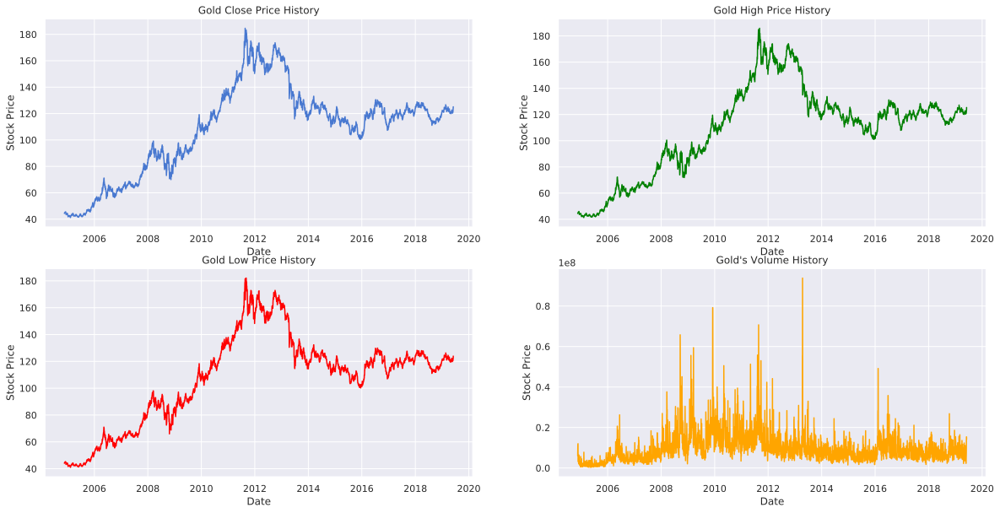

In [7]:
#Simple plot for gold 
# Simple plotting of Gold Stock Price
# First Subplot
f, [(ax1, ax2), (ax3, ax4)] = plt.subplots(2, 2, figsize=(20,10))
ax1.plot(df_visual["date"], df_visual["close"])
ax1.set_xlabel("Date", fontsize=12)
ax1.set_ylabel("Stock Price")
ax1.set_title("Gold Close Price History")

# Second Subplot
ax2.plot(df_visual["date"], df_visual["high"], color="green")
ax2.set_xlabel("Date", fontsize=12)
ax2.set_ylabel("Stock Price")
ax2.set_title("Gold High Price History")

# Third Subplot
ax3.plot(df_visual["date"], df_visual["low"], color="red")
ax3.set_xlabel("Date", fontsize=12)
ax3.set_ylabel("Stock Price")
ax3.set_title("Gold Low Price History")

# Fourth Subplot
ax4.plot(df_visual["date"], df_visual["volume"], color="orange")
ax4.set_xlabel("Date", fontsize=12)
ax4.set_ylabel("Stock Price")
ax4.set_title("Gold's Volume History")
plt.show()

In [8]:
enable_plotly_in_cell()
trace = go.Ohlc(x=df_visual['date'],
                open=df_visual['open'],
                high=df_visual['high'],
                low=df_visual['low'],
                close=df_visual['close'],
               increasing=dict(line=dict(color= '#58FA58')),
                decreasing=dict(line=dict(color= '#FA5858')))

layout = {
    'title': 'Gold Historical Price',
    'xaxis': {'title': 'Date',
             'rangeslider': {'visible': False}},
    'yaxis': {'title': 'Gold Price (USD$/g)'}
}

data = [trace]

fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='simple_ohlc')

In [9]:
enable_plotly_in_cell()
last_two = df_visual.loc[df_visual['date'].dt.year > 2016]

g = last_two.groupby(["date"])
monthly_averages = g.aggregate({"open": np.mean, "high": np.mean, "low": np.mean, "close":np.mean})
monthly_averages.reset_index(level=0, inplace=True)

trace = go.Candlestick(x=monthly_averages['date'],
                       open=monthly_averages['open'].values.tolist(),
                       high=monthly_averages['high'].values.tolist(),
                       low=monthly_averages['low'].values.tolist(),
                       close=monthly_averages['close'].values.tolist(),
                      increasing=dict(line=dict(color= '#58FA58')),
                decreasing=dict(line=dict(color= '#FA5858')))

layout = {
    'title': 'Gold Historical Price <br> <i>For the Last two years </i>',
    'xaxis': {'title': 'Date',
             'rangeslider': {'visible': False}},
    'yaxis': {'title': 'Stock Price (USD$)'}
}


data = [trace]

fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='simple_ohlc')

In [0]:
# Moving Averages (10, 50 and 200)
df_visual['10_d_avg'] = df_visual.close.rolling(window=10).mean()
df_visual['50_d_avg'] = df_visual.close.rolling(window=50).mean()
df_visual['200_d_avg'] = df_visual.close.rolling(window=200).mean()
close_p = df_visual['close'].values.tolist()


# Variables to insert into plotly
ten_d = df_visual['10_d_avg'].values.tolist()
fifty_d = df_visual['50_d_avg'].values.tolist()
twoh_d = df_visual['200_d_avg'].values.tolist()
date = df_visual['date'].values.tolist()

# Set date as index
df_visual = df_visual.set_index('date')

In [11]:
enable_plotly_in_cell()
# Take off the date index
df_visual = df_visual.reset_index()

# Plotly
trace0 = go.Scatter(
    x = df_visual['date'],
    y = ten_d,
    name = '10-day MA',
    line = dict(
        color = ('#ff6347'),
        width = 4)
)
trace1 = go.Scatter(
    x = df_visual['date'],
    y = fifty_d,
    name = '50-day MA',
    line = dict(
        color = ('#92a1cf'),
        width = 4,
    dash="dot")
)
trace2 = go.Scatter(
    x = df_visual['date'],
    y = twoh_d,
    name = '200-day MA',
    line = dict(
        color = ('#2EF688'),
        width = 4,
        dash = 'dash') # dash options include 'dash', 'dot', and 'dashdot'
)

data = [trace0, trace1, trace2]


# Edit the layout
layout = dict(title = 'Moving Averages for Gold',
              xaxis = dict(title = 'Date'),
              yaxis = dict(title = 'Price'),
              paper_bgcolor='#FFF9F5',
              plot_bgcolor='#FFF9F5'
              )

fig = dict(data=data, layout=layout)
iplot(fig, filename='styled-line')

##Xây dựng bộ dữ liệu để train và xác minh

In [12]:
df = df_org.copy()
df.drop(['open', 'high', 'low', 'adj close', 'volume'],  axis=1, inplace=True)
df.rename(columns={'date' : 'ds', 'close' : 'y'}, inplace=True)
scaler = MinMaxScaler(feature_range=(0,1))
scaled_cols = scaler.fit_transform(df[['y']])
df[['y']] = scaled_cols
df_train = df[:-val_size].copy()
df_test = df[-val_size:].copy()
df_train.head()

,ds,y
0,2004-11-18,0.021768
1,2004-11-19,0.024559
1,2004-11-20,0.024559
1,2004-11-21,0.024559
2,2004-11-22,0.025745


## Xây dựng bộ dữ liệu cho mạng học sâu
Gộp chung train và test để xử lý, sau đó tách ra sau.




In [13]:
df_test['is_test'] = np.repeat(True, df_test.shape[0])
df_test['y'] = np.zeros(df_test.shape[0])
df_train['is_test'] = np.repeat(False, df_train.shape[0])
df_total = pd.concat([df_train, df_test])
display(df_total.head())
display(df_total.tail())


,ds,y,is_test
0,2004-11-18,0.021768,False
1,2004-11-19,0.024559,False
1,2004-11-20,0.024559,False
1,2004-11-21,0.024559,False
2,2004-11-22,0.025745,False


,ds,y,is_test
3655,2019-05-30,0.0,True
3656,2019-05-31,0.0,True
3656,2019-06-01,0.0,True
3656,2019-06-02,0.0,True
3657,2019-06-03,0.0,True


Thêm giá vàng của ngày hôm trước để đưa vào dự đoán

In [0]:
def shift_series(series, days):
    return series.transform(lambda x: x.shift(days))


def shift_series_in_df(df, series_names=[], days_delta=90):
    ret = pd.DataFrame(index=df.index.copy())
    str_sgn = 'future' if np.sign(days_delta) < 0 else 'past'
    for sn in series_names:
        ret[f'{sn}_{str_sgn}_{np.abs(days_delta)}'] = shift_series(df[sn], days_delta)
    return ret

    
def stack_shifted_sales(df, train_size, prediction_size):
    dfs = [df.copy()]
    for delta in range(1, train_size + 1):
        shifted = shift_series_in_df(df, series_names=['y'], days_delta=delta)
        dfs.append(shifted)
        
    for delta in range(1, prediction_size):
        shifted = shift_series_in_df(df, series_names=['y'], days_delta=-delta)
        dfs.append(shifted)
    return pd.concat(dfs, axis=1, sort=False, copy=False)

In [0]:
df_total = stack_shifted_sales(df_total, train_size=train_size, prediction_size=prediction_size)
df_total.dropna(inplace=True)

In [16]:
df_total.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5132 entries, 61 to 3596
Columns: 182 entries, ds to y_future_89
dtypes: bool(1), datetime64[ns](1), float64(180)
memory usage: 7.1 MB


In [0]:
sales_cols = [col for col in df_total.columns if '_y_' in col and '_y_' not in col]
stacked_sales_cols = [col for col in df_total.columns if '_y_' in col]
other_cols = [col for col in df_total.columns if col not in set(sales_cols) and col not in set(stacked_sales_cols)]

sales_cols = sorted(sales_cols)
stacked_sales_cols = sorted(stacked_sales_cols)

new_cols = other_cols + stacked_sales_cols + sales_cols

In [0]:
df_total = df_total.reindex(columns=new_cols)

In [19]:
df_total.tail()

,ds,y,is_test,y_past_1,y_past_2,y_past_3,...,y_future_84,y_future_85,y_future_86,y_future_87,y_future_88,y_future_89
3593,2019-03-02,0.562478,False,0.562478,0.577199,0.582083,...,0.0,0.0,0.0,0.0,0.0,0.0
3593,2019-03-03,0.562478,False,0.562478,0.562478,0.577199,...,0.0,0.0,0.0,0.0,0.0,0.0
3594,2019-03-04,0.560246,False,0.562478,0.562478,0.562478,...,0.0,0.0,0.0,0.0,0.0,0.0
3595,2019-03-05,0.561362,False,0.560246,0.562478,0.562478,...,0.0,0.0,0.0,0.0,0.0,0.0
3596,2019-03-06,0.000000,True,0.561362,0.560246,0.562478,...,0.0,0.0,0.0,0.0,0.0,0.0


In [0]:
assert df_total.isna().any().any() == False

### Tách thành train và test

In [0]:
df_train = df_total[df_total['is_test'] == False].drop('is_test', axis=1)
df_test = df_total[df_total['is_test'] == True].drop('is_test', axis=1)

## Training models
Tách thành vector đầu vào và đầu ra. Và tách một phần dữ liệu để model có thể tự đánh gía.

In [0]:
X_cols_stacked = [col for col in df_train.columns if '_past_' in col]
X_cols = X_cols_stacked

X = df_train[X_cols]

In [0]:
y_cols = [col for col in df_train.columns if col not in X_cols and 'ds' not in col]

y = df_train[y_cols]

In [24]:
X.head()

,y_past_1,y_past_2,y_past_3,y_past_4,y_past_5,y_past_6,...,y_past_85,y_past_86,y_past_87,y_past_88,y_past_89,y_past_90
61,0.009210,0.009000,0.005721,0.005721,0.005721,0.003419,...,0.024349,0.025745,0.024559,0.024559,0.024559,0.021768
62,0.008791,0.009210,0.009000,0.005721,0.005721,0.005721,...,0.026442,0.024349,0.025745,0.024559,0.024559,0.024559
63,0.010256,0.008791,0.009210,0.009000,0.005721,0.005721,...,0.026442,0.026442,0.024349,0.025745,0.024559,0.024559
63,0.010396,0.010256,0.008791,0.009210,0.009000,0.005721,...,0.028117,0.026442,0.026442,0.024349,0.025745,0.024559
63,0.010396,0.010396,0.010256,0.008791,0.009210,0.009000,...,0.028117,0.028117,0.026442,0.026442,0.024349,0.025745


In [25]:
y.head()

,y,y_future_1,y_future_2,y_future_3,y_future_4,y_future_5,...,y_future_84,y_future_85,y_future_86,y_future_87,y_future_88,y_future_89
61,0.008791,0.010256,0.010396,0.010396,0.010396,0.010396,...,0.009977,0.006279,0.004814,0.004814,0.004814,0.004326
62,0.010256,0.010396,0.010396,0.010396,0.010396,0.016117,...,0.006279,0.004814,0.004814,0.004814,0.004326,0.004186
63,0.010396,0.010396,0.010396,0.010396,0.016117,0.015070,...,0.004814,0.004814,0.004814,0.004326,0.004186,0.005512
63,0.010396,0.010396,0.010396,0.016117,0.015070,0.014442,...,0.004814,0.004814,0.004326,0.004186,0.005512,0.005023
63,0.010396,0.010396,0.016117,0.015070,0.014442,0.015628,...,0.004814,0.004326,0.004186,0.005512,0.005023,0.002721


In [0]:
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, shuffle=False)

Cho dùng cho Keras thì cần biến đổi dữ liệu một xíu

In [0]:
X_train_vals = X_train.values.reshape((X_train.shape[0], 1, X_train.shape[1]))
X_valid_vals = X_valid.values.reshape((X_valid.shape[0], 1, X_valid.shape[1]))

### Định nghĩa mô hình

In [28]:
from keras.models import Sequential, Model
from keras.layers import LSTM, Dense, Conv1D, Input, Dropout, AvgPool1D, Reshape, Concatenate

Using TensorFlow backend.


Mô hình LSTM đơn giản

In [29]:
basic_model = Sequential()
basic_model.add(LSTM(500, input_shape=(X_train_vals.shape[1], X_train_vals.shape[2])))
basic_model.add(Dense(prediction_size))
basic_model.compile(loss='mae', optimizer='adam')

W0621 09:37:44.869111 139799869421440 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0621 09:37:44.889551 139799869421440 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0621 09:37:44.893207 139799869421440 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0621 09:37:45.546527 139799869421440 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.



Mô hình LSTM chồng chất

In [30]:
complex_model = Sequential()
complex_model.add(LSTM(units=100, input_shape=(X_train_vals.shape[1], X_train_vals.shape[2]), return_sequences=True))
complex_model.add(Dropout(rate=0.2))
complex_model.add(LSTM(100, return_sequences=False))
complex_model.add(Dropout(rate=0.2))
complex_model.add(Dense(prediction_size, activation='linear'))
complex_model.compile(loss='mae', optimizer='adam')

W0621 09:37:45.793830 139799869421440 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:133: The name tf.placeholder_with_default is deprecated. Please use tf.compat.v1.placeholder_with_default instead.

W0621 09:37:45.802388 139799869421440 deprecation.py:506] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:3445: calling dropout (from tensorflow.python.ops.nn_ops) with keep_prob is deprecated and will be removed in a future version.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


Bắt đầu train model

In [31]:
basic_history = basic_model.fit(
    X_train_vals, 
    y_train.values, 
    epochs=60, 
    batch_size=30,
    validation_data=(X_valid_vals, y_valid.values),
    verbose=2,
    shuffle=False
)

W0621 09:37:46.376920 139799869421440 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
W0621 09:37:46.821559 139799869421440 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:986: The name tf.assign_add is deprecated. Please use tf.compat.v1.assign_add instead.



Train on 4104 samples, validate on 1027 samples
Epoch 1/60
 - 3s - loss: 0.0614 - val_loss: 0.0946
Epoch 2/60
 - 1s - loss: 0.0672 - val_loss: 0.1480
Epoch 3/60
 - 1s - loss: 0.0671 - val_loss: 0.2016
Epoch 4/60
 - 1s - loss: 0.0632 - val_loss: 0.2225
Epoch 5/60
 - 1s - loss: 0.0737 - val_loss: 0.2396
Epoch 6/60
 - 1s - loss: 0.0888 - val_loss: 0.1652
Epoch 7/60
 - 1s - loss: 0.0918 - val_loss: 0.1605
Epoch 8/60
 - 1s - loss: 0.0903 - val_loss: 0.1536
Epoch 9/60
 - 1s - loss: 0.0971 - val_loss: 0.1385
Epoch 10/60
 - 1s - loss: 0.1236 - val_loss: 0.1546
Epoch 11/60
 - 1s - loss: 0.1244 - val_loss: 0.0903
Epoch 12/60
 - 1s - loss: 0.1184 - val_loss: 0.0630
Epoch 13/60
 - 1s - loss: 0.1132 - val_loss: 0.0534
Epoch 14/60
 - 1s - loss: 0.1088 - val_loss: 0.0529
Epoch 15/60
 - 1s - loss: 0.1067 - val_loss: 0.0521
Epoch 16/60
 - 1s - loss: 0.1036 - val_loss: 0.0516
Epoch 17/60
 - 1s - loss: 0.1006 - val_loss: 0.0532
Epoch 18/60
 - 1s - loss: 0.1024 - val_loss: 0.0542
Epoch 19/60
 - 1s - loss:

In [0]:
def plot_history(history):
    plt.plot(history.history['loss'], label='train')
    plt.plot(history.history['val_loss'], label='test')
    plt.legend()
    plt.show()

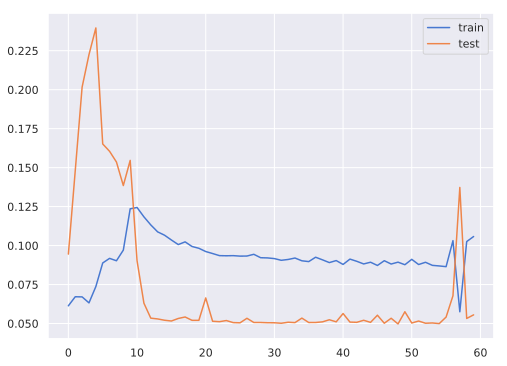

In [33]:
plot_history(basic_history)

In [34]:
complex_history = complex_model.fit(
    X_train_vals, 
    y_train.values, 
    epochs=130, 
    batch_size=70,
    validation_data=(X_valid_vals, y_valid.values),
    verbose=2,
    shuffle=False
)

Train on 4104 samples, validate on 1027 samples
Epoch 1/130
 - 2s - loss: 0.1190 - val_loss: 0.0650
Epoch 2/130
 - 1s - loss: 0.0872 - val_loss: 0.0969
Epoch 3/130
 - 1s - loss: 0.1080 - val_loss: 0.1637
Epoch 4/130
 - 1s - loss: 0.1550 - val_loss: 0.1534
Epoch 5/130
 - 1s - loss: 0.1254 - val_loss: 0.1364
Epoch 6/130
 - 1s - loss: 0.1973 - val_loss: 0.0908
Epoch 7/130
 - 1s - loss: 0.1016 - val_loss: 0.0856
Epoch 8/130
 - 1s - loss: 0.1648 - val_loss: 0.0707
Epoch 9/130
 - 1s - loss: 0.1159 - val_loss: 0.0808
Epoch 10/130
 - 1s - loss: 0.2069 - val_loss: 0.0612
Epoch 11/130
 - 1s - loss: 0.1159 - val_loss: 0.0608
Epoch 12/130
 - 1s - loss: 0.1315 - val_loss: 0.0547
Epoch 13/130
 - 1s - loss: 0.1365 - val_loss: 0.0538
Epoch 14/130
 - 1s - loss: 0.1459 - val_loss: 0.0534
Epoch 15/130
 - 1s - loss: 0.1197 - val_loss: 0.0566
Epoch 16/130
 - 1s - loss: 0.1540 - val_loss: 0.0885
Epoch 17/130
 - 1s - loss: 0.1223 - val_loss: 0.0766
Epoch 18/130
 - 1s - loss: 0.1310 - val_loss: 0.0502
Epoch 1

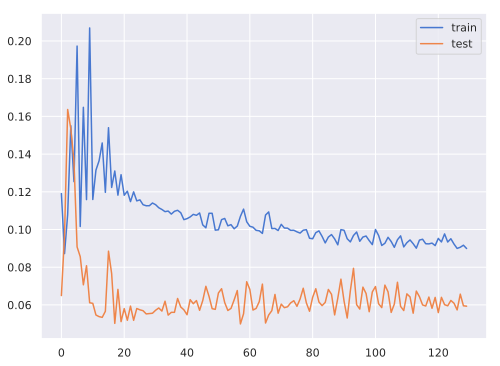

In [35]:
plot_history(complex_history)

### Đánh giá mạng học sâu

In [36]:
df_test.describe()

,y,y_past_1,y_past_2,y_past_3,y_past_4,y_past_5,...,y_future_84,y_future_85,y_future_86,y_future_87,y_future_88,y_future_89
count,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.0,1.0,1.0,1.0,1.0,1.0
mean,0.0,0.561362,0.560246,0.562478,0.562478,0.562478,...,0.0,0.0,0.0,0.0,0.0,0.0
std,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN
min,0.0,0.561362,0.560246,0.562478,0.562478,0.562478,...,0.0,0.0,0.0,0.0,0.0,0.0
25%,0.0,0.561362,0.560246,0.562478,0.562478,0.562478,...,0.0,0.0,0.0,0.0,0.0,0.0
50%,0.0,0.561362,0.560246,0.562478,0.562478,0.562478,...,0.0,0.0,0.0,0.0,0.0,0.0
75%,0.0,0.561362,0.560246,0.562478,0.562478,0.562478,...,0.0,0.0,0.0,0.0,0.0,0.0
max,0.0,0.561362,0.560246,0.562478,0.562478,0.562478,...,0.0,0.0,0.0,0.0,0.0,0.0


In [0]:
test_input = df_test[X_cols].values[0].reshape(1, 1, X_train.shape[1])
test_date = df_test.ds.values[0]

In [38]:
y_pred  = basic_model.predict(test_input)
date_rng = pd.date_range(start=test_date, periods=prediction_size, freq='D')
test_df_basic = pd.DataFrame(date_rng, columns=['ds'])
y_pred = scaler.inverse_transform(y_pred)
y_pred = pd.Series(y_pred.flatten())
test_df_basic['yhat'] = y_pred
df_test = df[-val_size:].copy()
test_df_basic['y'] = pd.Series(scaler.inverse_transform(df_test['y'].values.reshape(1, -1)).flatten())
display(test_df_basic.tail())


,ds,yhat,y
85,2019-05-30,122.681252,121.690002
86,2019-05-31,116.860229,123.330002
87,2019-06-01,116.285469,123.330002
88,2019-06-02,122.183403,123.330002
89,2019-06-03,124.189865,125.110001


In [39]:
y_pred = complex_model.predict(test_input)
date_rng = pd.date_range(start=test_date, periods=prediction_size, freq='D')
test_df_complex = pd.DataFrame(date_rng, columns=['ds'])
display(y_pred.shape)
y_pred = scaler.inverse_transform(y_pred)
y_pred = pd.Series(y_pred.flatten())
test_df_complex['yhat'] = y_pred
df_test = df[-val_size:].copy()
test_df_complex['y'] = pd.Series(scaler.inverse_transform(df_test['y'].values.reshape(1, -1)).flatten())
display(test_df_complex.tail())

(1, 90)

,ds,yhat,y
85,2019-05-30,126.223030,121.690002
86,2019-05-31,126.139328,123.330002
87,2019-06-01,125.916466,123.330002
88,2019-06-02,125.934647,123.330002
89,2019-06-03,125.685822,125.110001


In [40]:
for err_name, err_value in calculate_forecast_errors(test_df_basic, val_size).items():
    print('Basic Model', err_name, err_value)

Basic Model MAPE 2.0887032114642827
Basic Model MAE 2.5444802126790362


In [41]:
for err_name, err_value in calculate_forecast_errors(test_df_complex, val_size).items():
    print('Complex Model', err_name, err_value)

Complex Model MAPE 3.9192376657029753
Complex Model MAE 4.76704836575521


## Prophet:
Prophet là thư viện của Facebook để dự báo chuỗi thời gian. Prophet hoạt động tốt nhất với các bộ dữ liệu chịu ảnh hưởng lớn bởi tính thời vụ (hóa đơn tiền điện, khách đến nhà hàng, v.v.) 

####Các bước để sử dụng Prophet:
<ul>
  <li>Hãy chắc chắn rằng đổi tên giá đóng phiên thành y và ngày thành ds.</li>
 <li>Train dữ liệu để Prophet có thể dự đoán<li>
</ul>


In [0]:
ph_df = df_org.copy()
ph_df.drop(['open', 'high', 'low', 'adj close', 'volume'],  axis=1, inplace=True)
ph_df.rename(columns={'date' : 'ds', 'close' : 'y'}, inplace=True)
ph_df_train = ph_df[:-val_size].copy()
ph_train_last_date = ph_df_train[-1:].ds.dt.to_pydatetime()[0]
ph_df_val = ph_df[-val_size:].copy()

In [43]:
m = Prophet(yearly_seasonality=True, weekly_seasonality=True, daily_seasonality=True)

m.fit(ph_df_train)

In [44]:
# Create Future dates
future_prices = m.make_future_dataframe(periods=val_size)

# Predict Prices
forecast = m.predict(future_prices)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5311 entries, 0 to 5310
Data columns (total 4 columns):
ds            5311 non-null datetime64[ns]
yhat          5311 non-null float64
yhat_lower    5311 non-null float64
yhat_upper    5311 non-null float64
dtypes: datetime64[ns](1), float64(3)
memory usage: 166.0 KB


In [45]:
enable_plotly_in_cell()


fig = plot_plotly(m, forecast)  # This returns a plotly Figure
iplot(fig, filename='forecast_daily')

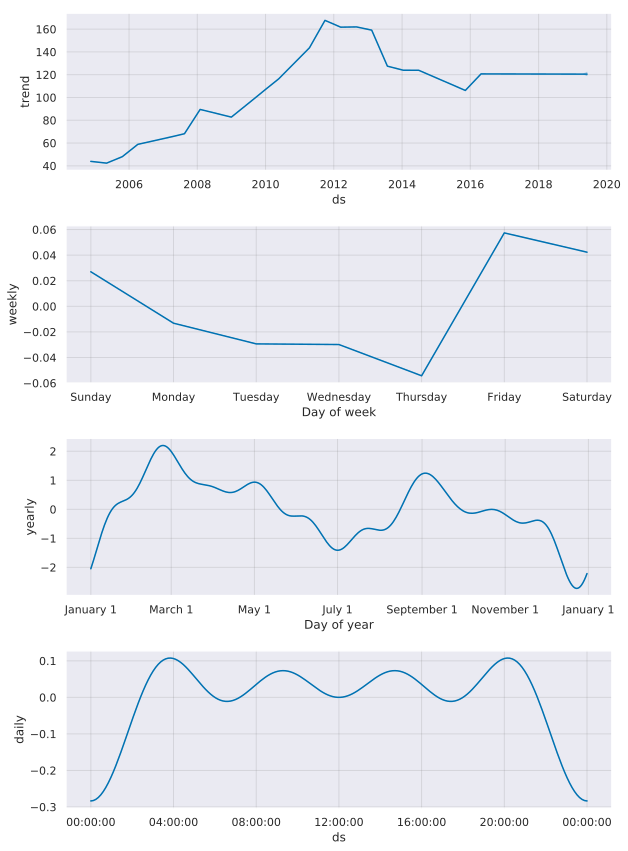

In [46]:
fig2 = m.plot_components(forecast)
plt.show()

### Đánh giá prophet

In [47]:
forecast_plot = forecast.loc[forecast.ds > ph_train_last_date]
cmp_ph_df = make_comparison_dataframe(ph_df_val,forecast_plot)
display(cmp_ph_df.tail())
for err_name, err_value in calculate_forecast_errors(cmp_ph_df, val_size, 'y', 'yhat').items():
    print('Prophet', err_name, err_value)

,yhat,yhat_lower,yhat_upper,y
ds,,,,
2019-05-30,119.921878,113.821622,125.742951,121.690002
2019-05-31,120.034259,113.714298,126.060263,123.330002
2019-06-01,120.021632,113.957915,126.270790,123.330002
2019-06-02,120.009437,114.203758,126.331025,123.330002
2019-06-03,119.971900,113.618136,126.370872,125.110001


Prophet MAPE 0.9996892461313345
Prophet MAE 1.2269345402104381


##Vẽ biểu đồ các phương pháp đánh giá

In [48]:
enable_plotly_in_cell()

# Plotly
trace0 = go.Scatter(
    x = test_df_basic['ds'],
    y = test_df_basic['y'],
    name = 'Thực tế',
    line = dict(
        color = ('#5042f4'),
        width = 4)
)

trace1 = go.Scatter(
    x = test_df_basic['ds'],
    y = test_df_basic['yhat'],
    name = 'Mô hình đơn giản',
    line = dict(
        color = ('#821a0b'),
        width = 2)
)

trace2 = go.Scatter(
    x = test_df_complex['ds'],
    y = test_df_complex['yhat'],
    name = 'Mô hình phức tạp',
    line = dict(
        color = ('#005b4e'),
        width = 2) # dash options include 'dash', 'dot', and 'dashdot'
)

trace3 = go.Scatter(
    x = cmp_ph_df.index,
    y = cmp_ph_df['yhat'],
    name = 'Prophet',
    line = dict(
        color = ('#0b4482'),
        width = 2) # dash options include 'dash', 'dot', and 'dashdot'
) 

data = [trace0, trace1, trace2, trace3]


# Edit the layout
layout = dict(title = 'Biểu đồ dự đoán',
              xaxis = dict(title = 'Date'),
              yaxis = dict(title = 'Price'),
              paper_bgcolor='#FFF9F5',
              plot_bgcolor='#FFF9F5'
              )

fig = dict(data=data, layout=layout)
iplot(fig, filename='styled-line')